**Paper Name:** DiffDis: Empowering Generative Diffusion Model with Cross-Modal Discrimination Capability

**Authors:** Runhui Huang, Jianhua Han, Guansong Lu, Xiaodan Liang, Yihan Zeng, Wei Zhang, and Hang Xu

**Link:** https://openaccess.thecvf.com/content/ICCV2023/papers/Huang_DiffDis_Empowering_Generative_Diffusion_Model_with_Cross-Modal_Discrimination_Capability_ICCV_2023_paper.pdf

**Project Members:**
Furkan Genç,
Barış Sarper Tezcan

## Paper Summary

### Introduction

Recently, large-scale diffusion models, e.g., Stable Diffusion and DallE2, have shown remarkable results on image synthesis. On the other hand, large-scale cross-modal pretrained models (e.g., CLIP, ALIGN, and FILIP) are competent for various downstream tasks by learning to align vision and language embeddings. This paper explores the possibility of jointly modeling generation and discrimination. Specifically, the authors propose DiffDis to unify the cross-modal generative and discriminative pretraining into one single framework under the diffusion process.

DiffDis first formulates the image-text discriminative problem as a generative diffusion process of the text embedding from the text encoder conditioned on the image. Then, the authors propose a novel dual-stream network architecture, which fuses the noisy text embedding with the knowledge of latent images from different scales for image-text discriminative learning. Moreover, the generative and discriminative tasks can efficiently share the image-branch network structure in the multi-modality model. Benefiting from diffusion-based unified training, DiffDis achieves both better generation ability and cross-modal semantic alignment in one architecture.

Experimental results show that DiffDis outperforms single-task models on both the image generation and the image-text discriminative tasks, e.g., 1.65% improvement on average accuracy of zero-shot classification over 12 datasets and 2.42 improvement on FID of zero-shot image synthesis.

The contributions of the paper can be summarized as:

- The authors propose DiffDis to explore a unified vision-language diffusion model for both multi-modality generation and discrimination tasks.
- DiffDis reformulates the image-text discriminative problem by utilizing a generative diffusion process of the text embeddings conditioned on input images.
- A dual-stream network architecture and a diffusion-based unified training paradigm are proposed for jointly training the generative and discriminative tasks.
- Extensive experiments demonstrate that DiffDis outperforms single-task models, achieving a 1.65% improvement on average zero-shot classification accuracy across 12 datasets and a 2.42 improvement on FID of text-guided image generation.
- Additionally, DiffDis outperforms CLIP, with a 4.7% improvement on average zero-shot classification accuracy across 12 datasets and a 14.5% improvement on average R@1 of image-text retrieval tasks on Flickr30k and MSCOCO.

### Architecture Overview

#### Unified Model Architecture

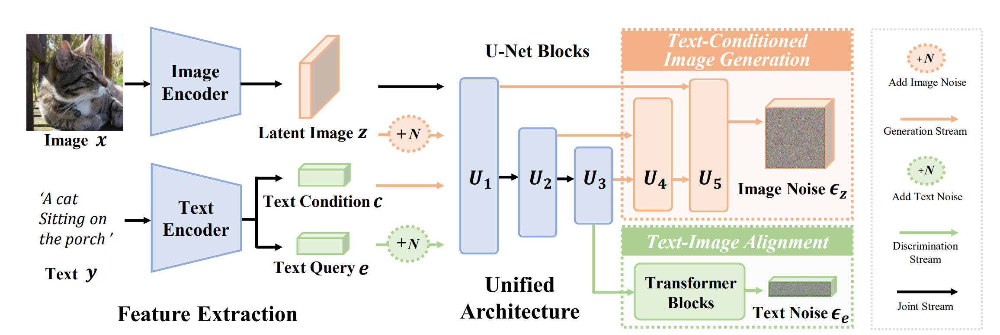

<div align="center">
Figure 1. Overall model architecture of DiffDis
</div>

<!-- <div align="center">
    <img src="images/dual_stream_deep_fusion_attention_block.png" alt="Figure 1. Overall model architecture of DiffDis">
    <p><em>Figure 1. Overall model architecture of DiffDis</em></p>
</div> -->

##### Feature Extraction Modules

As shown in the Fig. 1, DiffDis includes an image encoder to obtain the latent image $ z $ and a text encoder to obtain the text condition $ c $ and text query $ e $.

- **Image Encoder**:
  - The image encoder $ V $ of an autoencoder converts the image $ x $ from RGB space to its latent representation $ z $. This improves training efficiency and supports high-resolution image synthesis.

- **Text Encoder**:
  - The text encoder $ T $ encodes the text prompt $ y $ into the text condition $ c $ and text query $ e $.
  - The text condition $ c \in \mathbb{R}^{L \times d_y} $ is the token-wise representation of the text prompt $ y $.
  - The text query $ e \in \mathbb{R}^{1 \times d_y} $ is the normalized global representation of the text prompt $ y $.

The UNet structure receives three inputs: latent image $ z $, text condition $ c $, and text query $ e $.

- **Text-Conditional Image Generation Task**:
  - The model uses the noisy latent image $ z_t $ and text condition $ c $ as input to predict the noise $ \epsilon_z $ added to the latent image $ z $.

- **Diffusion-Based Image-Text Alignment Learning**:
  - The model uses the latent image $ z $ and noisy text query $ e_t $ as input to predict the original clean text query $ e $. It can also predict the noise $ \epsilon_e $ added to the text query $ e $ for alignment learning.

The model includes a unique transformer with $ M $ transformer blocks and a linear predictor:

- **Transformer**:
  - Follows the middle block of the UNet to obtain more semantic information.
  - The transformer's input is the concatenation of the flattened image's feature map and the text query outputted from the middle block of the UNet.

- **Linear Predictor**:
  - Fed by the text query token and predicts the original clean text query $ e $.

This unified approach allows for efficient training and effective handling of both generative and discriminative tasks within a single architecture.

#### Dual-stream Deep Fusion Attention Block

The authors modify the architecture of attention blocks in UNet to better unify the generative and discriminative tasks with different inputs. The previous stable diffusion model directly uses K transformer decoder blocks to inject text condition information into the latent image via a cross-attention mechanism. The proposed dual-stream deep fusion block enhances this process by better fusing the latent image knowledge into the text query for cross-modal alignment learning.

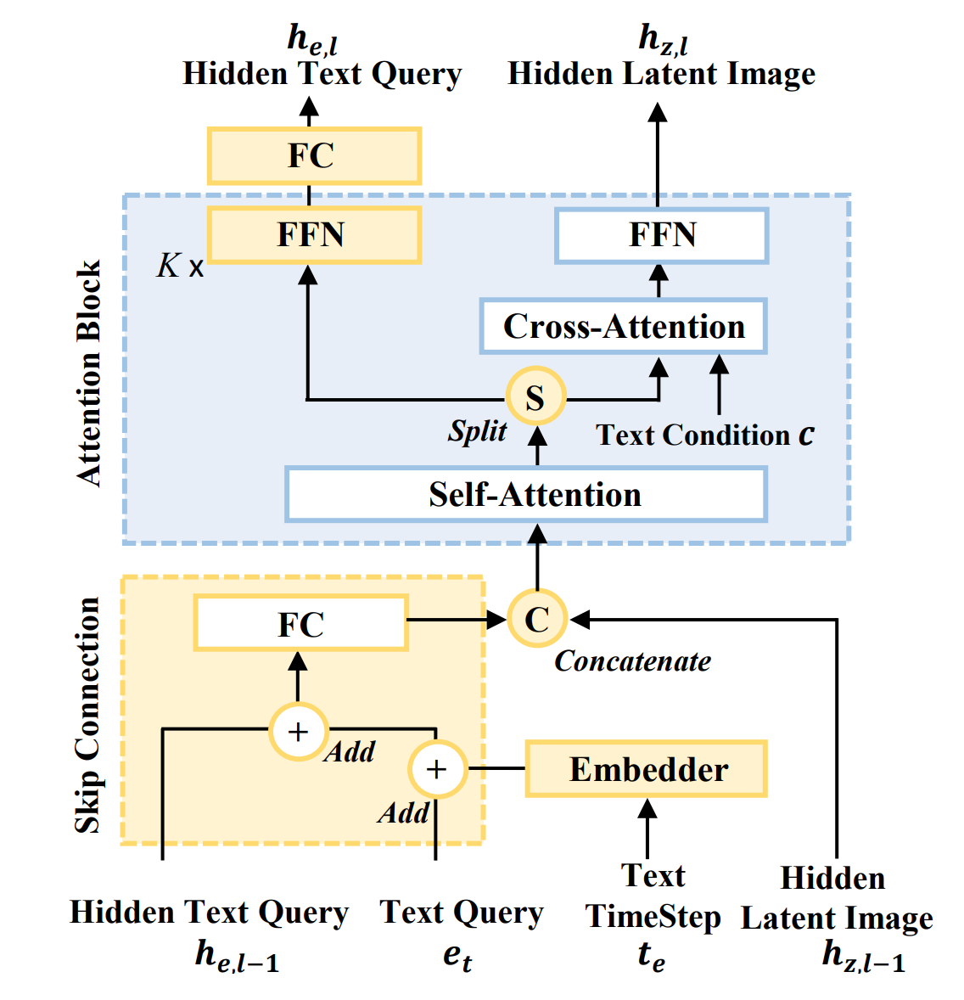

<div align="center">
Figure 2. Dual-stream Deep Fusion Block
</div>

<!-- <div align="center">
    <img src="images/dual_stream_deep_fusion_attention_block.png" alt="Dual-stream Deep Fusion Block">
    <p><em>Figure 2. Dual-stream Deep Fusion Block</em></p>
</div> -->


##### Key Components:

- **Fully Connected Layer**:
  - Projects the text query embedding into the same dimension as the hidden latent image space.
  
- **Concatenation and Transformer Blocks**:
  - The concatenated projected text query and the hidden latent image $ h_{z,l-1} $ outputted by the last block pass through K transformer blocks.
  - Each transformer block includes modality-specific feedforward neural networks (FFN) for text and image.
  - The text query skips the cross-attention layer within these transformer blocks.

- **Projection Back to Text Embedding Space**:
  - Following the transformer blocks, the concatenation of the text query and image hidden representations is separated.
  - The text query is projected back to the text embedding space using a fully-connected layer.

- **Cross-block Skip Connection**:
  - A skip connection is built from the noised text query $ e_t $ with the time condition to the hidden text query $ h_{e,l-1} $ outputted by the last block.
  - The hidden text query $ h_{e,l-1} $ is initialized to zero.

This dual-stream deep fusion attention block allows for more effective cross-modal alignment learning by incorporating both image and text information in a unified manner.

### Task Reformulation

#### Basic Notations

The image-text dataset is denoted as $ D = \{x_i, y_i\}_{i=1}^N $, where $ x_i $ and $ y_i $ denote the $ i $-th image and text, respectively. $ N $ is the total number of image-text pairs. As shown in Fig. 2, DiffDis consists of an image encoder $ V $ and a text encoder $ T $. Additionally, $ \Phi_u $ and $ \Phi_\theta $ represent the UNet model used for text-conditional image generation, and the encoder part of the UNet model with additional transformer blocks for image-text alignment learning, respectively.

#### Diffusion-based Text-conditioned Image Generation

The generative part of DiffDis aims to generate images conditioned on input text prompts. Following standard diffusion models, DiffDis generates image samples by gradually removing the noise from a random Gaussian noise signal over a finite number of steps. The diffusion model is trained by adding and predicting different levels of noise on the image in the opposite direction of the sampling process.

**Training Procedure**:

The diffusion process of an image can be represented as a parameterized Markov chain, which adds $ T $ steps of random Gaussian noise $ \epsilon $ to gradually convert the original image $ x_0 $ to a random Gaussian distribution $ x_T $. Utilizing the latent image $ z = V(x) \in \mathbb{R}^{H \times W \times d_x} $ outputted by the image encoder $ V $ instead of the RGB space of image $ x $ as the input signal, the diffusion-based text-conditional image generation loss $ \mathcal{L}_{IG} $, which aims to predict the added Gaussian noise, can be formulated as:

**Equation 1: Loss function for text-conditional image generation**
$$
\mathcal{L}_{IG} = \mathbb{E}_{\mathcal{V}(x), \epsilon_z \sim \mathcal{N}(0, I), t_z}\left [ \| \epsilon_z - \Phi_u(z_t, t_z, c) \|^2 \right ]
$$


where the text condition $ c = T(y) \in \mathbb{R}^{L \times d_y} $ denotes the token-wise representations of the text prompt $ y $. $ L $ and $ d_y $ represent the context length and embedding dimensions of the outputted token embeddings, respectively.

**Inference Procedure**:

During the inference (sampling) process, starting from a random Gaussian noise $ z_T \sim \mathcal{N}(0, I) $, the diffusion process is reversed, and the predicted noise $ \Phi_u(z_t, t_z, c) $ is gradually removed to obtain the sampled latent image after finite steps. An image decoder $ D $ is used to convert the sampled latent image back to RGB space $ \hat{x} = D(\hat{z}_0) $. The DDIM sampler and classifier-free guidance are employed.

#### Diffusion-based Image-text Alignment Pretraining

Previous methods perform image-text alignment pretraining by aligning the visual feature and textual feature in a common semantic space, where the positive image-text pairs are pulled towards each other and the negative image-text pairs are pushed against each other. The image-text contrastive (ITC) loss, like in CLIP, first calculates the cosine similarity of normalized visual feature $ v_i $ and textual feature $ e_j $ to measure the relevance of each image and text:

$$
s_{i,j}^y = s_{i,j}^x = v_i^\top e_j
$$

where $ s_{i,j}^x $, $ s_{i,j}^y $ denote the image-to-text similarity and the text-to-image similarity, respectively. $ v_i $ is the global representation of the image $ x_i $ and $ e_j $ is the global representation of the text $ y_i $.

To reformulate this image-text alignment problem into a diffusion process, the authors propose the denoising diffusion-based image-text alignment, which treats the latent image $ z $ as the condition and learns the distribution of the corresponding text embedding $ e \in \mathbb{R}^{1 \times d_y} $. The diffusion process of $ e $ can be formulated as:

$$
e_t = \gamma \sqrt {\bar {\alpha }_t} e_0 + \sqrt {1-\bar {\alpha }_t} \epsilon _e, \\
\alpha _t = 1-\beta _t, \bar {\alpha }_t = \prod _{j=0}^t \alpha _j,
$$

where $ \beta_t $ is used to control the strength of added noise for timestep $ t_e $. The $ \gamma \in (0, 1] $ is the scale factor to scale the text embedding $ e_0 $.

In contrast to the image generation task, the diffusion model $ \Phi_\theta $ is trained to estimate the original clean text query $ \hat{e}_0 = \Phi_\theta(e_t, t_e, z) $. Note that $ \Phi_\theta $ can also be a noise prediction model to predict the noise $ \epsilon_e $.

Then, the diffusion-based image-text alignment objective is to minimize the distance between $ \hat{e}_0 $ and $ e $. The cosine similarity between $ \hat{e}_0 $ and $ e $ is calculated as:

$$
s = \hat {e}_0 ^\top e
$$

The diffusion-based image-text alignment loss $ \mathcal{L}_{ITA} $ can be calculated as:

**Equation 2: Loss function for image-text alignment**
$$
\mathcal{L}_{ITA} =-\frac {1}{2B}\sum ^{B}_{i=1}\left [\log \frac {\exp (s_{i,i}^x)}{ \sum _{j} \exp (s_{i,j}^x)} + \log \frac {\exp (s_{i,i}^y)}{ \sum _{j} \exp (s_{j, i}^y)}\right ]
$$

where $ B $ denotes the batch size, and $ \mathcal{L}_{ITA} $ is calculated for each diffusion step during training.

### Diffusion-based Unified Training

In this section, the authors introduce a training paradigm to unify diffusion-based image generation training and cross-modal alignment learning into a single framework. The whole training algorithm is illustrated in Algorithm 1.

To alternatively feed the required inputs and conditions when performing diffusion-based generation and alignment tasks, a masking mechanism is introduced to erase unnecessary input. The input space includes the latent image $ z $ outputted by the image encoder, text condition $ c $, and text query $ e $ outputted by the text encoder. Text-conditional image generation sampling and image-text alignment inference algorithms are given in Algorithm 2 and Algorithm 3 respectively.

- **Image Generation Task**:
  - Mask the text query $ e $.
  - Feed the noisy latent image $ z_t $ with time step $ t $ and text condition $ c $ into the following UNet model.

- **Image-Text Alignment Learning**:
  - Mask the text condition $ c $ to avoid leaking textual information.
  - Feed the noisy text query $ e_t $ with time step $ t $ and the latent image $ z $ as the condition.

Considering the image generation loss $ \mathcal{L}_{IG} $ from Eq. 1 and the diffusion-based image-text alignment loss $ \mathcal{L}_{ITA} $ from Eq. 2, the total loss of DiffDis $ \mathcal{L}_{Total} $ can be calculated as:

$$
\mathcal{L}_{Total} = \mathcal{L}_{IG} + \lambda \mathcal{L}_{ITA}
$$

where $ \lambda $ denotes the weight factor.

#### Algorithm 1: Diffusion-based Unified Training
**Input:** Image $x$, Text $y$, Image Encoder $\mathcal{V}$, Text Encoder $\mathcal{T}$, Timestep $T$.

1. **repeat**
2. &emsp;$c, e = \mathcal{T}(y)$  ⟶ Get text condition and text query
3. &emsp;$z = \mathcal{V}(x)$
4. &emsp;$t_z, t_e \sim \text{Uniform}(\{1, \ldots, T\})$
5. &emsp;$\epsilon_z, \epsilon_e \sim \mathcal{N}(0, I)$
6. &emsp;Mask $e$ and calculate $\mathcal{L}_{IG}$ based on Eq. 4.
7. &emsp;Mask $c$ and calculate $\mathcal{L}_{ITA}$ based on Eq. 8.
8. &emsp;Calculate total loss $\mathcal{L}$ based on Eq. 9
9. &emsp;Take gradient descent step on $\nabla_{u, \theta} \mathcal{L}_{Total}$
10. **until** converged


#### Algorithm 2: Text-conditional Image Generation Sampling
**Input:** Text $y$, Text Encoder $\mathcal{T}$, Image Decoder $\mathcal{D}$, Timestep $T$, Noise Schedule $\{\beta_t\}_{t=1}^T$, Classifier-free guidance scale $w$.

1. $z_T \sim \mathcal{N}(0, I)$
2. $c = \mathcal{T}(y)$
3. $\alpha_t = 1 - \beta_t, \bar{\alpha_t} = \prod_{k=1}^t \alpha_t$
4. **for** $t = T, \ldots, 1$ **do** ⟶ For simplify, $t$ stands for $t_z$.
5. &emsp;$\hat{\epsilon_z} = (1 + w)\Phi_u(z_t, t, c) - w\Phi_u(z_t, t)$
6. &emsp;$z_{t-1} = \sqrt{\bar{\alpha}_{t-1}}\left(\frac{z_t - \sqrt{1 - \bar{\alpha_t}}\hat{\epsilon_z}}{\sqrt{\alpha_t}}\right) + \sqrt{1 - \bar{\alpha}_{t-1}}\hat{\epsilon_z}$
7. **end for**
8. **return** $\mathcal{D}(z_0)$

#### Algorithm 3: Image-text Alignment Inference
**Input:** Image $x$, Text $y'$ of Downstream Task, Image Encoder $\mathcal{V}$, Text Encoder $\mathcal{T}$, Timestep $T$, Noise Schedule $\{\beta_t\}_{t=1}^T$, Classifier-free guidance scale $w$.

1. $e_T \sim \mathcal{N}(0, I)$
2. $z = \mathcal{V}(x)$
3. $\alpha_t = 1 - \beta_t, \bar{\alpha_t} = \prod_{k=1}^t \alpha_t$
4. **for** $t = T, \ldots, 1$ **do** ⟶ For simplify, $t$ stands for $t_e$.
5. &emsp;$\hat{e_0} = (1 + w)\Phi_\theta(e_t, t, z) - w\Phi_\theta(e_t, t)$
6. &emsp;$\hat{\epsilon_e} = (e_t - \sqrt{\bar{\alpha_t}}\hat{e_0})/\sqrt{1 - \bar{\alpha_t}}$
7. &emsp;$e_{t-1} = \sqrt{\bar{\alpha}_{t-1}}\left(\frac{e_t - \sqrt{1 - \bar{\alpha_t}}\hat{\epsilon_e}}{\sqrt{\alpha_t}}\right) + \sqrt{1 - \bar{\alpha}_{t-1}}\hat{\epsilon_e}$
8. **end for**
9. $e_0 = e_0 / \| e_0 \|$ ⟶ L2 Normalize
10. $e = \mathcal{T}(y')$ ⟶ Extract Text Embedding
11. $e = e / \| e \|$ ⟶ L2 Normalize
12. **Perform the similarity** $e_0^T e$ **on downstream tasks.**


# **Workflow**

### Project Setup

#### Setup Environment

To set up the environment for this project, please follow the steps below:

1. **Create a new conda environment** named `DiffDis`:
    ```bash
    conda create -n DiffDis
    ```

2. **Activate** the newly created environment:
    ```bash
    conda activate DiffDis
    ```

3. **Install PyTorch** and related libraries with CUDA support:
    ```bash
    conda install pytorch torchvision torchaudio pytorch-cuda=11.8 -c pytorch -c nvidia
    ```

4. **Install additional required Python packages** from the `requirements.txt` file:
    ```bash
    pip install -r requirements.txt
    ```

#### Change Directory

Navigate to the `scripts` directory where the project scripts are located:
```bash
cd scripts
```

#### Download Data

To download the necessary data for the project, execute the following script:
```bash
bash download_data.sh
```

#### Download and Extract CC3M Dataset

To download and extract the CC3M dataset, run the following scripts in order:

1. **Download the CC3M dataset**:
    ```bash
    bash download_cc3m_dataset.sh
    ```

2. **Extract the downloaded CC3M dataset**:
    ```bash
    bash extract_cc3m_dataset.sh
    ```

### Initialize Parameters
Set up the necessary constants and parameters for the model training, such as image dimensions, batch size, training parameters, optimizer parameters, and file paths. Additionally, define text prompts and sampler settings for generating images.

### Training Procedure

**Initialization and Setup**: Import required libraries, set up the device (CPU/GPU), and load models. Define parameters for model training such as batch size, learning rate, and number of epochs.

**Training Loop**:
- **Data Encoding**: Encode images and texts into latent representations.
- **Noise Addition**: Add noise to latents and texts to simulate the diffusion process.
- **Noise Prediction**: Use the model to predict the noise added during the diffusion process.
- **Loss Computation**: Calculate the loss based on the predicted and actual noise values.
- **Backpropagation and Weight Update**: Perform backpropagation to compute gradients and update model weights.
- **Model Saving**: Save the model state at regular intervals and whenever a new best model (based on loss) is found.
- **Sample Generation**: Generate sample images using the model and save them for validation purposes.

### Inference

Load the trained model and use it to generate images based on provided text prompts. The inference pipeline includes tokenizing the text prompts, encoding them, and generating corresponding images by reversing the diffusion process.

### Testing

**Dataset Preparation**: Load the test dataset (e.g., CIFAR-10 or CIFAR-100) and apply necessary transformations.

**Model Evaluation**: Move models to the evaluation mode and device. Encode test data and use the model to predict class labels or generate images.

**Performance Metrics**: Calculate accuracy and loss, and compare the results with original values reported in the paper. Analyze qualitative and quantitative results to assess the model's performance.

By following this workflow, the implementation integrates data preparation, model definition, training, inference, and testing into a cohesive process, enabling efficient and effective handling of both generative and discriminative tasks within the DiffDis framework.

# **Project Setup**

In [ ]:
# Setup the Environment
%conda create -n DiffDis
%conda activate DiffDis
%conda install pytorch torchvision torchaudio pytorch-cuda=11.8 -c pytorch -c nvidia
%pip install -r requirements.txt

# Navigate to the `scripts` directory where the project scripts are located:
%cd scripts

# Download the necessary data for the project, execute the following script:
%bash download_data.sh

#Download the CC3M dataset**:
%bash download_cc3m_dataset.sh

#Extract the downloaded CC3M dataset**:
%bash extract_cc3m_dataset.sh

# **Important Remark**

In the following sections, we will provide a detailed guide on how to set up the project environment, download the necessary data, and run the scripts for training, inference, and testing. 

For the demonstration, we used the first batch of the CC3M dataset, which contains 5046 image-text pairs. This small dataset allows us to run the scripts quickly and demonstrate the workflow without requiring extensive computational resources. The model trained on the whole CC3M dataset for two-thirds of an epoch can be found in this [link](https://drive.google.com/uc?id=1iVTS0fYkmKkT4s5EcZoMC9L8-p29dW41).

# **Parameters**

In [2]:
import torch

# Set the device
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# define the constants
WIDTH = 512
HEIGHT = 512
LATENTS_WIDTH = WIDTH // 8
LATENTS_HEIGHT = HEIGHT // 8
BATCH_SIZE = 1
root_dir = "../dataset/cc3m/train"

# training parameters
num_train_epochs = 6
Lambda = 1.0
save_steps = 1000

# optimizer parameters
learning_rate = 1e-5
discriminative_learning_rate = 1e-4  # New learning rate for discriminative tasks
adam_beta1 = 0.9
adam_beta2 = 0.999
adam_weight_decay = 1e-4
adam_epsilon = 1e-8
use_contrastive_loss = False

# IMAGE TO TEXT
test_dataset = "CIFAR10"  # Set to "CIFAR100" to use CIFAR100 dataset

# output directory
train_output_dir = "../results/output_1"
test_output_dir = "../results/" + test_dataset
inference_output_dir = "../results/text_to_image/output_1/last"

# Load the models
model_file = "data/v1-5-pruned.ckpt"
train_unet_file = None  # Set to None to finetune from scratch, if specified, the diffusion model will be loaded from this file
test_unet_file = "../results/output_1/last.pt"
inference_unet_file = "../results/output_1/last.pt"

# EMA parameters
use_ema = False  # Set to True to use EMA
ema_decay = 0.9999
warmup_steps = 1000

# TEXT TO IMAGE
prompt1 = "A river with boats docked and houses in the background"
prompt2 = "A piece of chocolate swirled cake on a plate"
prompt3 = "A large bed sitting next to a small Christmas Tree surrounded by pictures"
prompt4 = "A bear searching for food near the river"
prompts = [prompt1, prompt2, prompt3, prompt4]
uncond_prompt = ""  # Also known as negative prompt
do_cfg = True
cfg_scale = 3  # min: 1, max: 14
num_samples = 1

# SAMPLER
sampler = "ddpm"
num_inference_steps = 50
seed = 42

# **Training**

### Imports and Initializations

In [ ]:
import torch
import torch.nn.functional as F
import os
from tqdm import tqdm
from ddpm import DDPMSampler
from pipeline import get_time_embedding
from dataloader import train_dataloader
import model_loader
import time
from diffusion import TransformerBlock, UNet_Transformer  # Ensure these are correctly imported

import pipeline
from PIL import Image
from pathlib import Path
from transformers import CLIPTokenizer

# Load the models
models = model_loader.preload_models_from_standard_weights(model_file, DEVICE)
ddpm = DDPMSampler(generator=None)

if train_unet_file is not None:
    # Load the UNet model
    print(f"Loading UNet model from {train_unet_file}")
    models['diffusion'].load_state_dict(torch.load(train_unet_file)['model_state_dict'])
    if 'best_loss' in torch.load(train_unet_file):
        best_loss = torch.load(train_unet_file)['best_loss']
        best_step = torch.load(train_unet_file)['best_step']
        last_loss = torch.load(train_unet_file)['last_loss']
        last_step = torch.load(train_unet_file)['last_step']
    else:
        best_loss = float('inf')
        best_step = 0
        last_loss = 0.0
        last_step = 0
else:
    best_loss = float('inf')
    best_step = 0
    last_loss = 0.0
    last_step = 0

# TEXT TO IMAGE
tokenizer = CLIPTokenizer("./data/vocab.json", merges_file="./data/merges.txt")

# Disable gradient computations for the models['encoder'], DDPM, and models['clip'] models
for param in models['encoder'].parameters():
    param.requires_grad = False

for param in models['clip'].parameters():
    param.requires_grad = False

# Set the models['encoder'] and models['clip'] to eval mode
models['encoder'].eval()
models['clip'].eval()

# Separate parameters for discriminative tasks
discriminative_params = []
non_discriminative_params = []

for name, param in models['diffusion'].named_parameters():
    if isinstance(getattr(models['diffusion'], name.split('.')[0], None), (TransformerBlock, UNet_Transformer)):
        discriminative_params.append(param)
    else:
        non_discriminative_params.append(param)

# AdamW optimizer with separate learning rates
optimizer = torch.optim.AdamW([
    {'params': non_discriminative_params, 'lr': learning_rate},
    {'params': discriminative_params, 'lr': discriminative_learning_rate}
], betas=(adam_beta1, adam_beta2), weight_decay=adam_weight_decay, eps=adam_epsilon)

if train_unet_file is not None:
    print(f"Loading optimizer state from {train_unet_file}")
    optimizer.load_state_dict(torch.load(train_unet_file)['optimizer_state_dict'])

# Linear warmup scheduler for non-discriminative parameters
def warmup_lr_lambda(current_step: int):
    if current_step < warmup_steps:
        return float(current_step) / float(max(1, warmup_steps))
    return 1.0

scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=[
    warmup_lr_lambda,  # Apply warmup for non-discriminative params
    lambda step: 1.0  # Keep constant learning rate for discriminative params
])

# EMA setup
if use_ema:
    ema_unet = torch.optim.swa_utils.AveragedModel(models['diffusion'], avg_fn=lambda averaged_model_parameter, model_parameter, num_averaged: ema_decay * averaged_model_parameter + (1 - ema_decay) * model_parameter)

/home/furkan/miniconda3/envs/DiffDis/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Loading samples: 5046/5046
Loaded 5046 samples.



### Training Loop

In [ ]:
def train(num_train_epochs, device="cuda", save_steps=1000):
    global best_loss, best_step, last_loss, last_step

    if train_unet_file is not None:
        first_epoch = last_step // len(train_dataloader)
        global_step = last_step + 1
    else:
        first_epoch = 0
        global_step = 0

    accumulator = 0

    # Move models to the device
    models['encoder'].to(device)
    models['clip'].to(device)
    models['diffusion'].to(device)
    if use_ema:
        ema_unet.to(device)

    num_train_epochs = tqdm(range(first_epoch, num_train_epochs), desc="Epoch")
    for epoch in num_train_epochs:
        train_loss = 0.0
        num_train_steps = len(train_dataloader)
        for step, batch in enumerate(train_dataloader):
            start_time = time.time()

            # Extract images and texts from batch
            images = batch["pixel_values"]
            texts = batch["input_ids"]

            # Move batch to the device
            images = images.to(device)
            texts = texts.to(device)

            # Encode images to latent space
            encoder_noise = torch.randn(images.shape[0], 4, LATENTS_HEIGHT, LATENTS_WIDTH).to(device)  # Shape (BATCH_SIZE, 4, 32, 32)
            latents = models['encoder'](images, encoder_noise)

            # Sample noise and timesteps for diffusion process
            bsz = latents.shape[0]
            timesteps = torch.randint(0, ddpm.num_train_timesteps, (bsz,), device=latents.device).long()
            text_timesteps = torch.randint(0, ddpm.num_train_timesteps, (bsz,), device=latents.device).long()

            # Add noise to latents and texts
            noisy_latents, image_noise = ddpm.add_noise(latents, timesteps)
            encoder_hidden_states = models['clip'](texts)
            noisy_text_query, text_noise = ddpm.add_noise(encoder_hidden_states, text_timesteps)

            # Get time embeddings
            image_time_embeddings = get_time_embedding(timesteps, is_image=True).to(device)
            text_time_embeddings = get_time_embedding(timesteps, is_image=False).to(device)

            # Average and normalize text time embeddings
            average_noisy_text_query = noisy_text_query.mean(dim=1)
            text_query = F.normalize(average_noisy_text_query, p=2, dim=-1)

            # Randomly drop 10% of text and image conditions: Context Free Guidance
            if torch.rand(1).item() < 0.1:
                text_query = torch.zeros_like(text_query)
            if torch.rand(1).item() < 0.1:
                noisy_latents = torch.zeros_like(noisy_latents)

            # Predict the noise residual and compute loss
            image_pred, text_pred = models['diffusion'](noisy_latents, encoder_hidden_states, image_time_embeddings, text_time_embeddings, text_query)
            image_loss = F.mse_loss(image_pred.float(), image_noise.float(), reduction="mean")

            if use_contrastive_loss:
                # Assuming margin is predefined, e.g., margin = 1.0
                margin = 1.0
                # Assuming all pairs are similar
                target = torch.ones(text_pred.size(0)).to(device)
                text_loss = F.cosine_embedding_loss(text_pred.float(), text_query.float(), target, margin)
            else:
                text_loss = F.mse_loss(text_pred.float(), text_query.float(), reduction="mean")

            loss = image_loss + Lambda * text_loss
            train_loss += loss.item()
            accumulator += loss.item()

            # Backpropagate
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
            scheduler.step()
            if use_ema:
                ema_unet.update_parameters(models['diffusion'])

            end_time = time.time()

            if train_unet_file is not None and epoch == first_epoch:
                print(f"Step: {step+1+last_step}/{num_train_steps+last_step}   Loss: {loss.item()}   Time: {end_time - start_time}", end="\r")
            else:
                print(f"Step: {step}/{num_train_steps}   Loss: {loss.item()}   Time: {end_time - start_time}", end="\r")

            if global_step % save_steps == 0 and global_step > 0:
                # Check if the current step's loss is the best
                if accumulator / save_steps < best_loss:
                    best_loss = accumulator / save_steps
                    best_step = global_step
                    best_save_path = os.path.join(train_output_dir, "best.pt")
                    if use_ema:
                        torch.save({
                            'model_state_dict': models['diffusion'].state_dict(),
                            'ema_state_dict': ema_unet.state_dict(),
                            'optimizer_state_dict': optimizer.state_dict(),
                            'best_loss': best_loss,
                            'best_step': best_step,
                            'last_loss': accumulator / save_steps,
                            'last_step': global_step
                        }, best_save_path)
                    else:
                        torch.save({
                            'model_state_dict': models['diffusion'].state_dict(),
                            'optimizer_state_dict': optimizer.state_dict(),
                            'best_loss': best_loss,
                            'best_step': best_step,
                            'last_loss': accumulator / save_steps,
                            'last_step': global_step
                        }, best_save_path)

                    print(f"\nNew best model saved to {best_save_path} with loss {best_loss}")

                # Save model and optimizer state
                last_save_path = os.path.join(train_output_dir, f"last.pt")
                if use_ema:
                    torch.save({
                        'model_state_dict': models['diffusion'].state_dict(),
                        'ema_state_dict': ema_unet.state_dict(),
                        'optimizer_state_dict': optimizer.state_dict(),
                        'best_loss': best_loss,
                        'best_step': best_step,
                        'last_loss': accumulator / save_steps,
                        'last_step': global_step
                    }, last_save_path)
                else:
                    torch.save({
                        'model_state_dict': models['diffusion'].state_dict(),
                        'optimizer_state_dict': optimizer.state_dict(),
                        'best_loss': best_loss,
                        'best_step': best_step,
                        'last_loss': accumulator / save_steps,
                        'last_step': global_step
                    }, last_save_path)

                print(f"Saved state to {last_save_path}")

                # Generate samples from the model
                for i, prompt in enumerate(prompts):
                    # Sample images from the model
                    output_image = pipeline.generate(
                        prompt=prompt,
                        uncond_prompt=uncond_prompt,
                        input_image=None,
                        strength=0.9,
                        do_cfg=do_cfg,
                        cfg_scale=cfg_scale,
                        sampler_name=sampler,
                        n_inference_steps=num_inference_steps,
                        seed=seed,
                        models=models,
                        device=DEVICE,
                        idle_device=DEVICE,
                        tokenizer=tokenizer,
                    )

                    # Save the generated image
                    output_image = Image.fromarray(output_image)

                    # Display the generated image
                    display(output_image)

                print(f"\nSaved images for step {global_step}")
                print('Epoch: %d   Step: %d   Loss: %.5f   Best Loss: %.5f   Best Step: %d\n' % (epoch+1, global_step, accumulator / save_steps, best_loss, best_step))

                accumulator = 0.0

            global_step += 1

        print(f"Average loss over epoch: {train_loss / (step + 1)}")

### Start Training

==> Training starts..

Model file: data/v1-5-pruned.ckpt
UNet file: None
Batch size: 1
Width: 512
Height: 512
Latents width: 64
Latents height: 64
First epoch: 0
Number of training epochs: 6
Lambda: 1.0
Learning rate: 1e-05
Discriminative learning rate: 0.0001
Adam beta1: 0.9
Adam beta2: 0.999
Adam weight decay: 0.0001
Adam epsilon: 1e-08
Use EMA: False
EMA decay: 0.9999
Warmup steps: 1000
Output directory: ../results/output_1
Save steps: 5000
Device: cuda
Sampler: ddpm
Number of inference steps: 50
Seed: 42
Prompt 1: A river with boats docked and houses in the background
Prompt 2: A piece of chocolate swirled cake on a plate
Prompt 3: A large bed sitting next to a small Christmas Tree surrounded by pictures
Prompt 4: A bear searching for food near the river
Unconditional prompt: 
Do CFG: True
CFG scale: 3




Epoch:   0%|          | 0/6 [00:00<?, ?it/s]/home/furkan/miniconda3/envs/DiffDis/lib/python3.12/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1712609048481/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:84.)
  return F.conv2d(input, weight, bias, self.stride,
/home/furkan/CENG796/code/pipeline.py:188: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  timesteps = torch.tensor(timesteps, dtype=torch.float32)[:, None] # convert the batch of timesteps to a 2-D tensor


Step: 5000/5046   Loss: 0.11019457876682281   Time: 0.1516003608703613388
New best model saved to ../results/output_1/best.pt with loss 0.2574170602272265
Saved state to ../results/output_1/last.pt


100%|██████████| 50/50 [00:04<00:00, 11.53it/s]


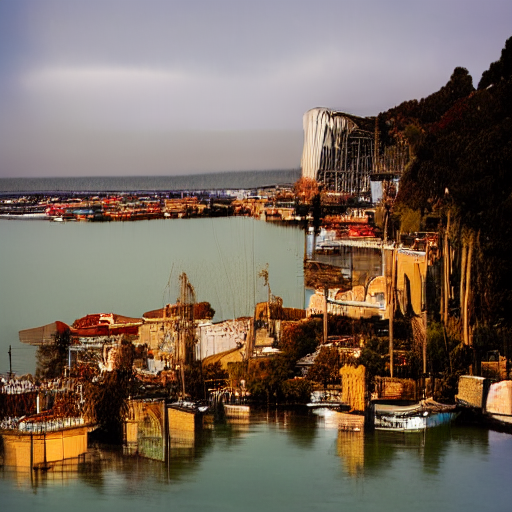

100%|██████████| 50/50 [00:04<00:00, 11.81it/s]


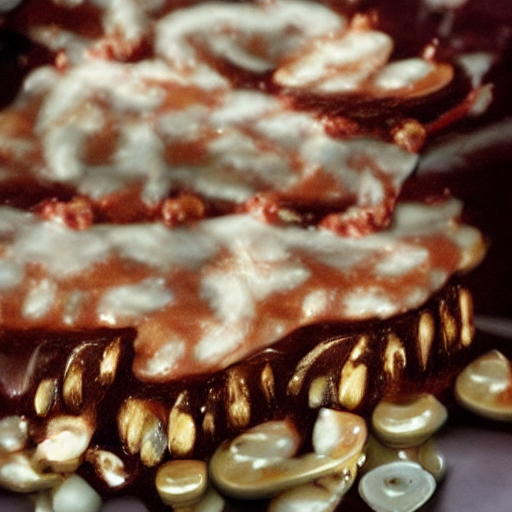

100%|██████████| 50/50 [00:04<00:00, 11.82it/s]


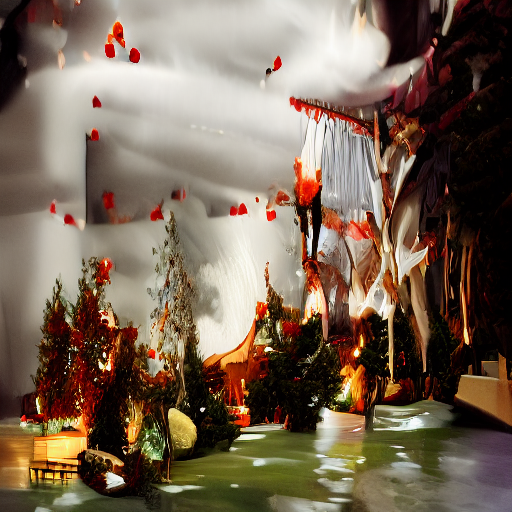

100%|██████████| 50/50 [00:04<00:00, 11.82it/s]


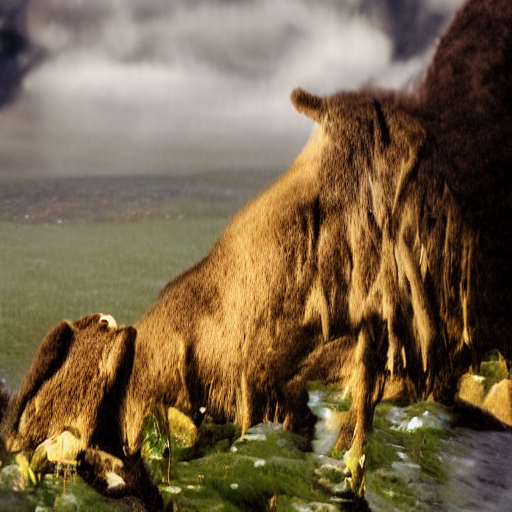


Saved images for step 5000
Epoch: 1   Step: 5000   Loss: 0.25742   Best Loss: 0.25742   Best Step: 5000



Epoch:  17%|█▋        | 1/6 [25:27<2:07:15, 1527.18s/it]

Average loss over epoch: 0.25731121857589336   Time: 0.1969141960144043
Step: 4954/5046   Loss: 0.17604000866413116   Time: 0.1969144344329834474
New best model saved to ../results/output_1/best.pt with loss 0.2406541142154485
Saved state to ../results/output_1/last.pt


100%|██████████| 50/50 [00:04<00:00, 11.83it/s]


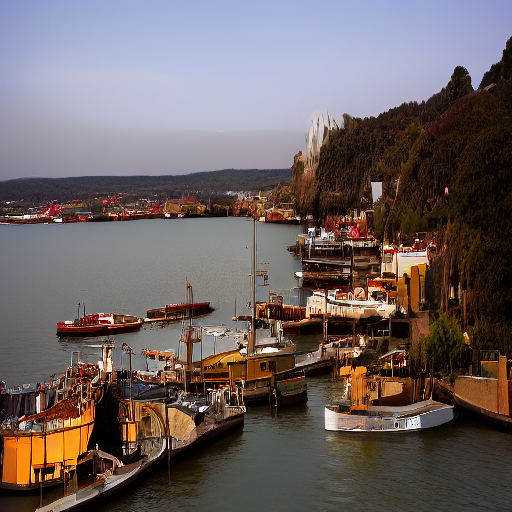

100%|██████████| 50/50 [00:04<00:00, 11.82it/s]


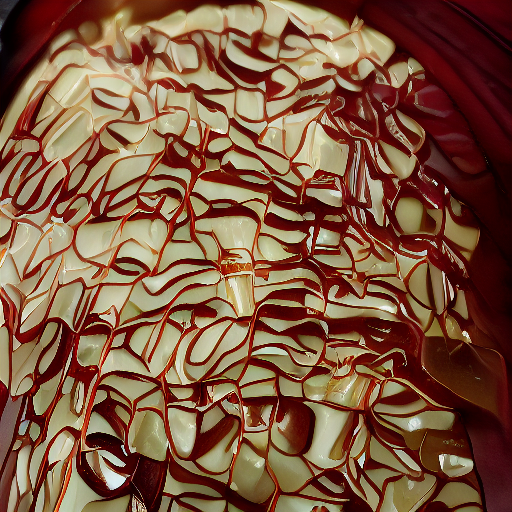

100%|██████████| 50/50 [00:04<00:00, 11.81it/s]


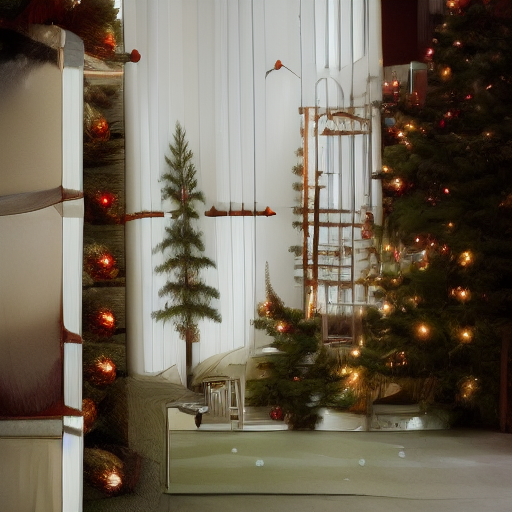

100%|██████████| 50/50 [00:04<00:00, 11.76it/s]


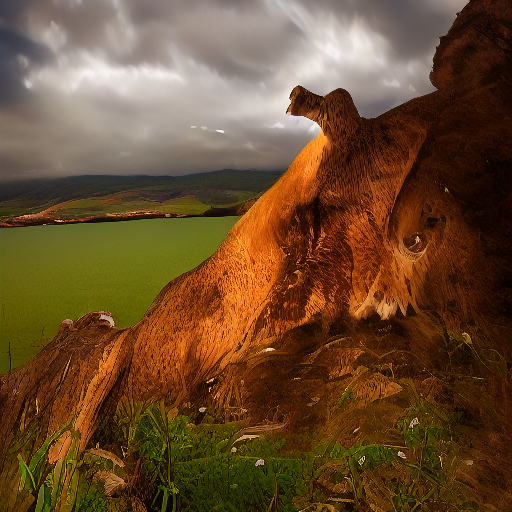


Saved images for step 10000
Epoch: 2   Step: 10000   Loss: 0.24065   Best Loss: 0.24065   Best Step: 10000



Epoch:  33%|███▎      | 2/6 [49:31<1:38:33, 1478.35s/it]

Average loss over epoch: 0.24081591752830642 Time: 0.19686222076416016
Step: 4908/5046   Loss: 0.0033800562378019094   Time: 0.19713997840881348
New best model saved to ../results/output_1/best.pt with loss 0.23109131355108692
Saved state to ../results/output_1/last.pt


100%|██████████| 50/50 [00:04<00:00, 11.83it/s]


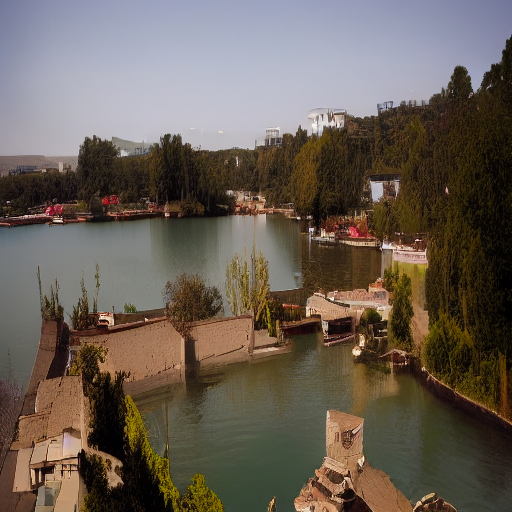

100%|██████████| 50/50 [00:04<00:00, 11.82it/s]


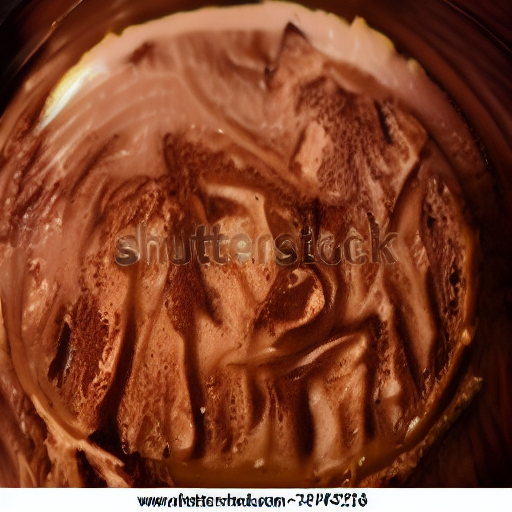

100%|██████████| 50/50 [00:04<00:00, 11.82it/s]


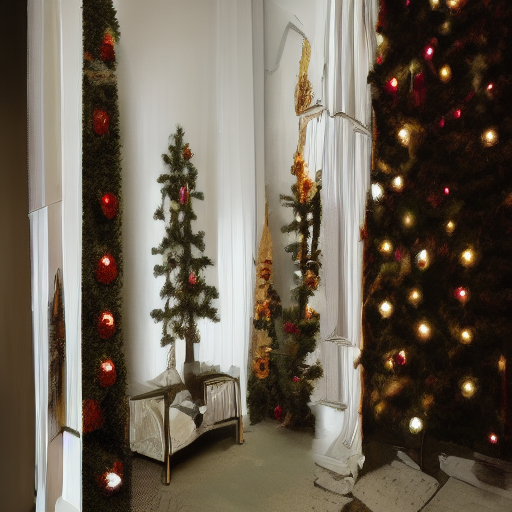

100%|██████████| 50/50 [00:04<00:00, 11.82it/s]


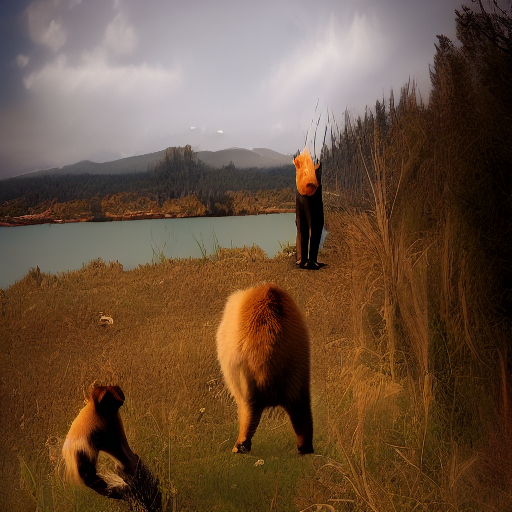


Saved images for step 15000
Epoch: 3   Step: 15000   Loss: 0.23109   Best Loss: 0.23109   Best Step: 15000



Epoch:  50%|█████     | 3/6 [1:13:07<1:12:29, 1449.88s/it]

Average loss over epoch: 0.2313138278532704  Time: 0.19705843925476074
Saved state to ../results/output_1/last.pt  Time: 0.197257280349731459523


100%|██████████| 50/50 [00:04<00:00, 11.82it/s]


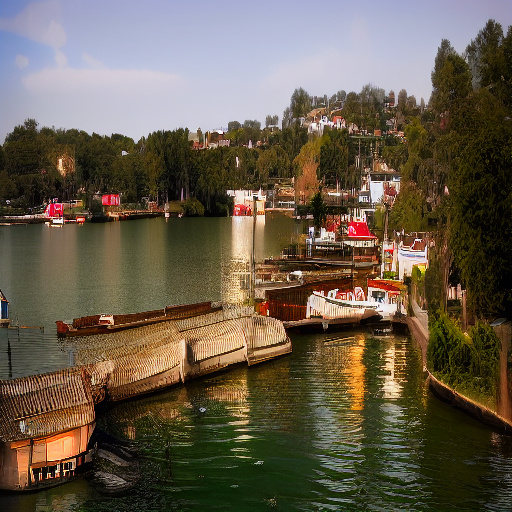

100%|██████████| 50/50 [00:04<00:00, 11.82it/s]


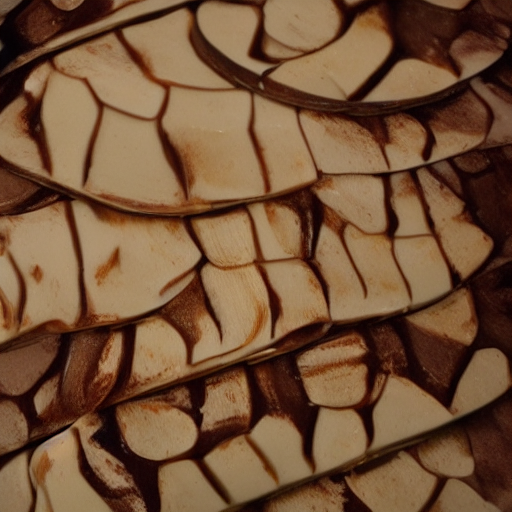

100%|██████████| 50/50 [00:04<00:00, 11.81it/s]


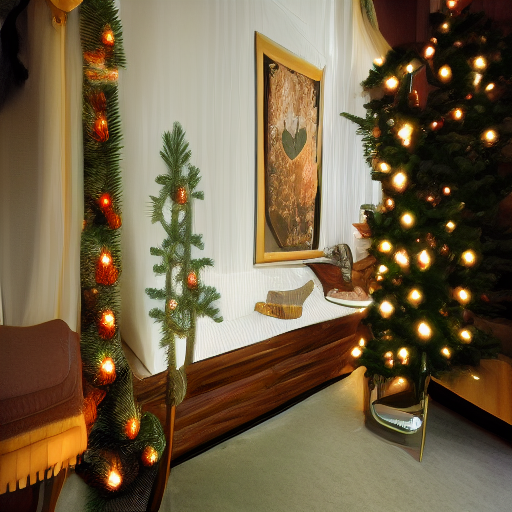

100%|██████████| 50/50 [00:04<00:00, 11.81it/s]


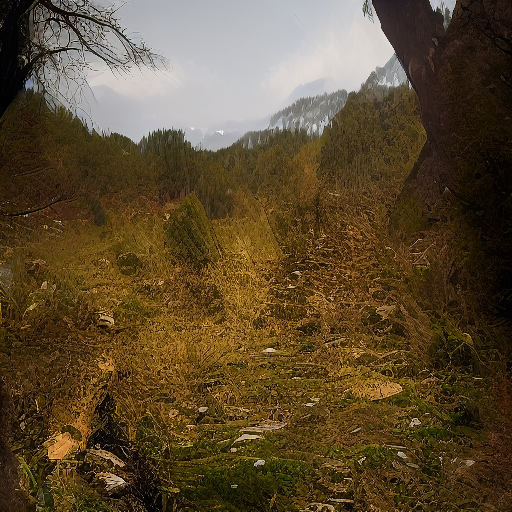


Saved images for step 20000
Epoch: 4   Step: 20000   Loss: 0.23762   Best Loss: 0.23109   Best Step: 15000



Epoch:  67%|██████▋   | 4/6 [1:36:32<47:44, 1432.32s/it]  

Average loss over epoch: 0.23832769447767252 Time: 0.20766687393188477
Saved state to ../results/output_1/last.pt9   Time: 0.1973145008087158282


100%|██████████| 50/50 [00:04<00:00, 11.81it/s]


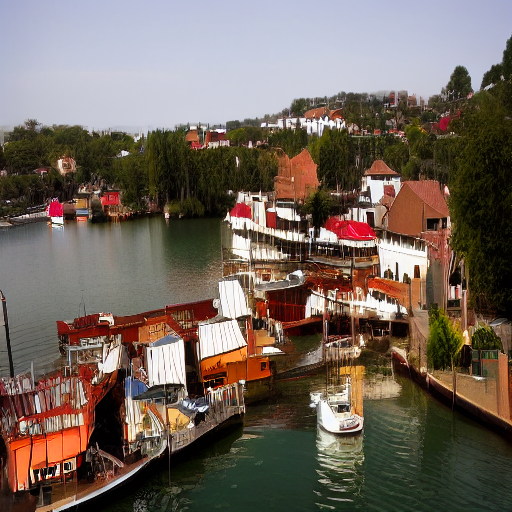

100%|██████████| 50/50 [00:04<00:00, 11.81it/s]


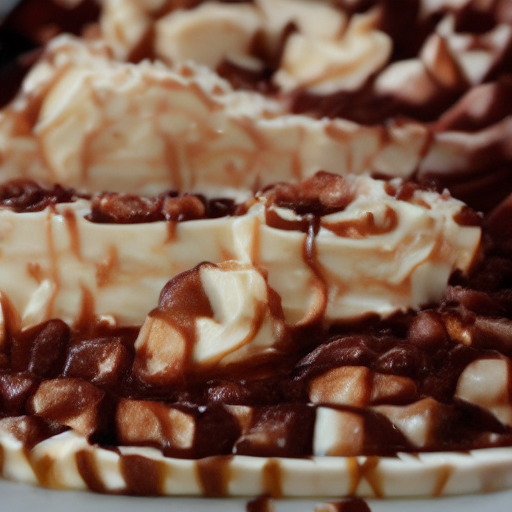

100%|██████████| 50/50 [00:04<00:00, 11.81it/s]


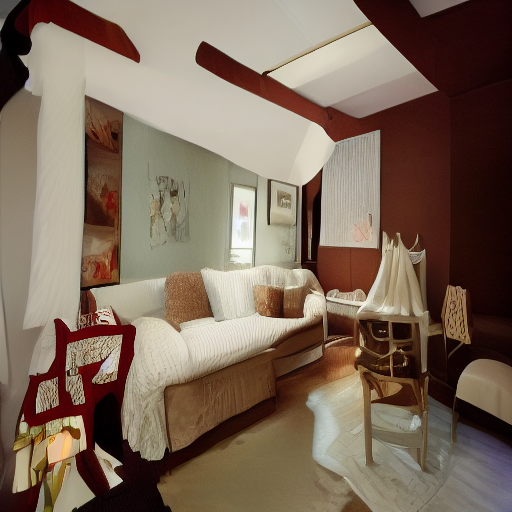

100%|██████████| 50/50 [00:04<00:00, 11.81it/s]


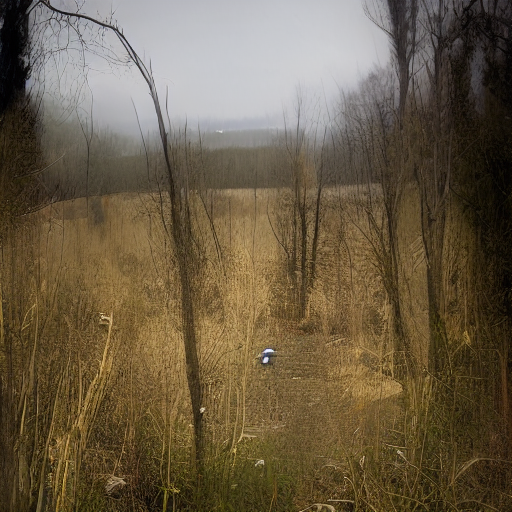


Saved images for step 25000
Epoch: 5   Step: 25000   Loss: 0.23724   Best Loss: 0.23109   Best Step: 15000



Epoch:  83%|████████▎ | 5/6 [1:59:59<23:43, 1423.16s/it]

Average loss over epoch: 0.23611877438210113  Time: 0.19716739654541016
Saved state to ../results/output_1/last.pt8   Time: 0.1971397399902343833


100%|██████████| 50/50 [00:04<00:00, 11.81it/s]


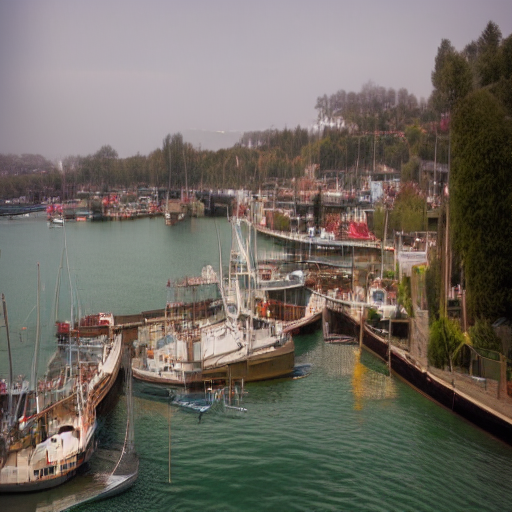

100%|██████████| 50/50 [00:04<00:00, 11.81it/s]


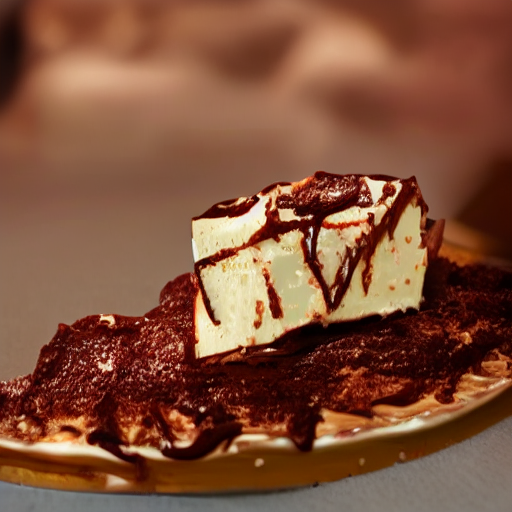

100%|██████████| 50/50 [00:04<00:00, 11.80it/s]


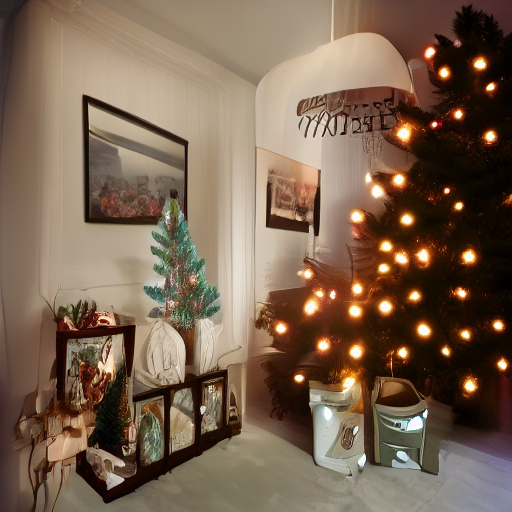

100%|██████████| 50/50 [00:04<00:00, 11.80it/s]


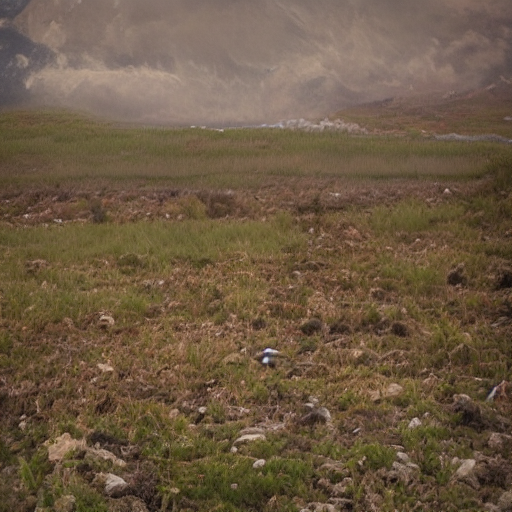


Saved images for step 30000
Epoch: 6   Step: 30000   Loss: 0.23115   Best Loss: 0.23109   Best Step: 15000



Epoch: 100%|██████████| 6/6 [2:23:25<00:00, 1434.26s/it]

Average loss over epoch: 0.23221419323251438  Time: 0.19747495651245117


In [ ]:
s = '==> Training starts..'
s += f'\n\nModel file: {model_file}'
s += f'\nUNet file: {train_unet_file}'
s += f'\nBatch size: {BATCH_SIZE}'
s += f'\nWidth: {WIDTH}'
s += f'\nHeight: {HEIGHT}'
s += f'\nLatents width: {LATENTS_WIDTH}'
s += f'\nLatents height: {LATENTS_HEIGHT}'
s += f'\nFirst epoch: {last_step // len(train_dataloader)}'
s += f'\nNumber of training epochs: {num_train_epochs}'
s += f'\nLambda: {Lambda}'
s += f'\nLearning rate: {learning_rate}'
s += f'\nDiscriminative learning rate: {discriminative_learning_rate}'
s += f'\nAdam beta1: {adam_beta1}'
s += f'\nAdam beta2: {adam_beta2}'
s += f'\nAdam weight decay: {adam_weight_decay}'
s += f'\nAdam epsilon: {adam_epsilon}'
s += f'\nUse contrastive loss: {use_contrastive_loss}'
s += f'\nUse EMA: {use_ema}'
s += f'\nEMA decay: {ema_decay}'
s += f'\nWarmup steps: {warmup_steps}'
s += f'\nOutput directory: {train_output_dir}'
s += f'\nSave steps: {save_steps}'
s += f'\nDevice: {DEVICE}'
s += f'\nSampler: {sampler}'
s += f'\nNumber of inference steps: {num_inference_steps}'
s += f'\nSeed: {seed}'
for i, prompt in enumerate(prompts):
    s += f'\nPrompt {i + 1}: {prompt}'
s += f'\nUnconditional prompt: {uncond_prompt}'
s += f'\nDo CFG: {do_cfg}'
s += f'\nCFG scale: {cfg_scale}'
s += f'\n\n'
print(s)

# Create the output directory
os.makedirs(train_output_dir, exist_ok=True)

train(num_train_epochs=num_train_epochs, device=DEVICE, save_steps=save_steps)

# Inference

/home/furkan/miniconda3/envs/DiffDis/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Loading UNet model from ../results/output_1/last.pt


  0%|          | 0/50 [00:00<?, ?it/s]/home/furkan/CENG796/code/pipeline.py:188: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  timesteps = torch.tensor(timesteps, dtype=torch.float32)[:, None] # convert the batch of timesteps to a 2-D tensor
/home/furkan/miniconda3/envs/DiffDis/lib/python3.12/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at /opt/conda/conda-bld/pytorch_1712609048481/work/aten/src/ATen/native/cudnn/Conv_v8.cpp:84.)
  return F.conv2d(input, weight, bias, self.stride,
100%|██████████| 50/50 [00:07<00:00,  6.58it/s]


PROMPT 1 - SAMPLE 1 - TIME: 7.85s



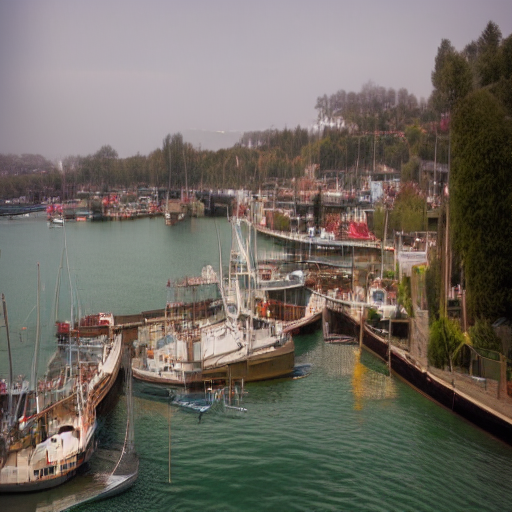

100%|██████████| 50/50 [00:07<00:00,  6.61it/s]


PROMPT 2 - SAMPLE 1 - TIME: 7.77s



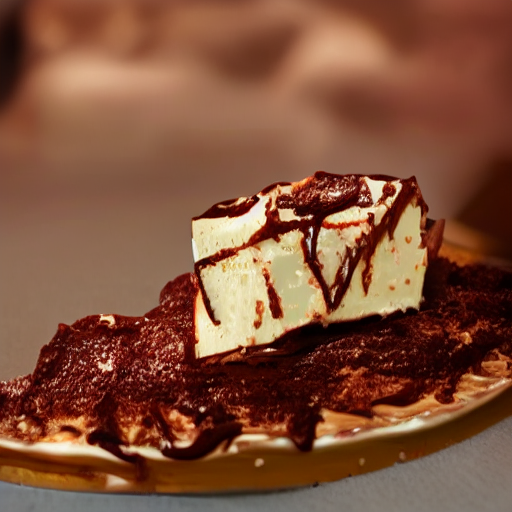

100%|██████████| 50/50 [00:07<00:00,  6.66it/s]


PROMPT 3 - SAMPLE 1 - TIME: 7.71s



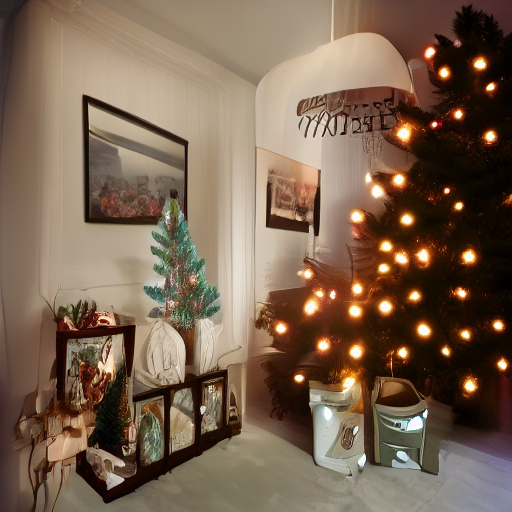

100%|██████████| 50/50 [00:07<00:00,  6.60it/s]


PROMPT 4 - SAMPLE 1 - TIME: 7.78s



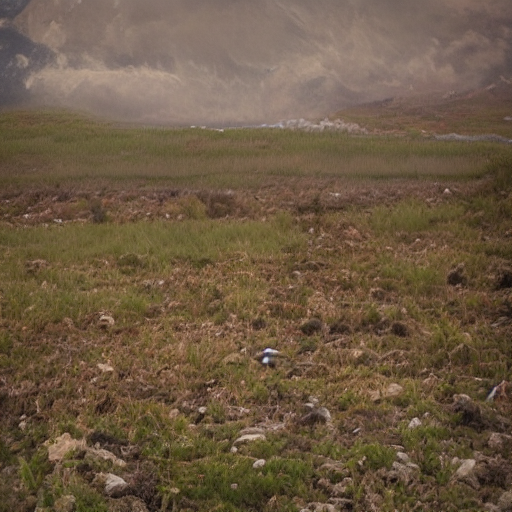

In [ ]:
import torch
import torch.nn.functional as F
import os
import model_loader
import time
import pipeline
from PIL import Image
from transformers import CLIPTokenizer
from IPython.display import display

# Load the models
models = model_loader.preload_models_from_standard_weights(model_file, DEVICE)

if inference_unet_file is not None:
    # Load the UNet model
    print(f"Loading UNet model from {inference_unet_file}")
    models['diffusion'].load_state_dict(torch.load(inference_unet_file)['model_state_dict'])

# TEXT TO IMAGE
tokenizer = CLIPTokenizer("./data/vocab.json", merges_file="./data/merges.txt")

# Generate samples from the model
for i, prompt in enumerate(prompts):
    for j in range(num_samples):
        start = time.time()

        # Sample images from the model
        output_image = pipeline.generate(
            prompt=prompt,
            uncond_prompt=uncond_prompt,
            input_image=None,
            strength=0.9,
            do_cfg=do_cfg,
            cfg_scale=cfg_scale,
            sampler_name=sampler,
            n_inference_steps=num_inference_steps,
            seed=seed,
            models=models,
            device=DEVICE,
            idle_device=DEVICE,
            tokenizer=tokenizer,
        )

        end = time.time()

        print(f"PROMPT {i+1} - SAMPLE {j+1} - TIME: {end - start:.2f}s\n")

        # Save the generated image
        output_image = Image.fromarray(output_image)

        # Display the generated image
        display(output_image)

# **Testing**

### Imports and Initializations

In [ ]:
import torch
import torchvision
from torchvision import transforms
import torch.nn.functional as F
import os
from ddpm import DDPMSampler
from pipeline import get_time_embedding
import model_loader
import time
from transformers import CLIPTokenizer

# Load the models
models = model_loader.preload_models_from_standard_weights(model_file, DEVICE)
ddpm = DDPMSampler(generator=None)

if test_unet_file is not None:
    # Load the UNet model
    print(f"Loading UNet model from {test_unet_file}")
    if use_ema:
        models['diffusion'].load_state_dict(torch.load(test_unet_file)['ema_state_dict'])
    else:
        models['diffusion'].load_state_dict(torch.load(test_unet_file)['model_state_dict'])

# TEXT TO IMAGE
tokenizer = CLIPTokenizer("./data/vocab.json", merges_file="./data/merges.txt")

# Set the models['encoder'], models['clip'], models['diffusion'] to eval mode
models['encoder'].eval()
models['clip'].eval()
models['diffusion'].eval()

print("==> Testing starts..")

Loading UNet model from ../results/output_1/last.pt
==> Testing starts..


### Testing Loop

In [ ]:
def test(device="cuda"):
    # Get the transform for the test data
    transform = transforms.Compose([
        transforms.Resize((WIDTH, HEIGHT), interpolation=transforms.InterpolationMode.BILINEAR),
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5])
    ])

    # Load the CIFAR-10 dataset
    if test_dataset == "CIFAR10":
        testset = torchvision.datasets.CIFAR10(
            root='../dataset', train=False, download=True, transform=transform)

    elif test_dataset == "CIFAR100":
        testset = torchvision.datasets.CIFAR100(
            root='../dataset', train=False, download=True, transform=transform)

    print(f"Test dataset: {test_dataset} | Number of test samples: {len(testset)}")

    # Load the test data
    testloader = torch.utils.data.DataLoader(
        testset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)

    # Move models to the device
    models['encoder'].to(device)
    models['clip'].to(device)
    models['diffusion'].to(device)

    # Define the class names and tokens
    class_names = testset.classes
    class_tokens = []

    # Tokenize class names
    for class_name in class_names:
        # Tokenize text
        tokens = tokenizer.batch_encode_plus(
            [class_name], padding="max_length", max_length=77
        ).input_ids
        tokens = torch.tensor(tokens, dtype=torch.long).squeeze()
        class_tokens.append(tokens)

    # Convert list of class tokens to a tensor
    class_tokens = torch.stack(class_tokens).to(device)
    print(f"Class tokens shape: {class_tokens.shape}")

    # Encode class tokens with the CLIP model
    with torch.no_grad():
        # Encode class tokens
        encoder_hidden_states = models['clip'](class_tokens)

        # Average and normalize class embeddings
        class_embeddings = encoder_hidden_states.mean(dim=1)
        class_embeddings = F.normalize(class_embeddings, p=2, dim=-1)
        print(f"Class embeddings shape: {class_embeddings.shape}\n")

    # Start testing
    test_loss = 0.0
    num_test_steps = len(testloader)
    correct_predictions = 0
    total_predictions = 0
    with torch.no_grad():
        for batch_idx, (images, targets) in enumerate(testloader):
            start_time = time.time()

            # Move batch to the device
            images = images.to(device)
            targets = targets.to(device)
            texts = [class_tokens[target] for target in targets]

            # Convert list of class tokens to a tensor
            texts = torch.stack(texts).to(device)

            # Encode images to latent space
            encoder_noise = torch.randn(images.shape[0], 4, LATENTS_HEIGHT, LATENTS_WIDTH).to(device)  # Shape (BATCH_SIZE, 4, 32, 32)
            latents = models['encoder'](images, encoder_noise)

            # Sample noise and timesteps for diffusion process
            bsz = latents.shape[0]
            timesteps = torch.randint(0, ddpm.num_train_timesteps, (bsz,), device=latents.device).long()
            text_timesteps = torch.randint(0, ddpm.num_train_timesteps, (bsz,), device=latents.device).long()

            # Add noise to latents and texts
            noisy_latents, image_noise = ddpm.add_noise(latents, timesteps)
            encoder_hidden_states = models['clip'](texts)
            noisy_text_query, text_noise = ddpm.add_noise(encoder_hidden_states, text_timesteps)

            # Get time embeddings
            image_time_embeddings = get_time_embedding(timesteps, is_image=True).to(device)
            text_time_embeddings = get_time_embedding(timesteps, is_image=False).to(device)

            # Average and normalize text time embeddings
            average_noisy_text_query = noisy_text_query.mean(dim=1)
            text_query = F.normalize(average_noisy_text_query, p=2, dim=-1)

            # Randomly drop 10% of text and image conditions: Context Free Guidance
            if torch.rand(1).item() < 0.1:
                text_query = torch.zeros_like(text_query)
            if torch.rand(1).item() < 0.1:
                noisy_latents = torch.zeros_like(noisy_latents)

            # Predict the noise residual and compute loss
            _, text_pred = models['diffusion'](noisy_latents, encoder_hidden_states, image_time_embeddings, text_time_embeddings, text_query)

            # Calculate loss
            if use_contrastive_loss:
                # Assuming margin is predefined, e.g., margin = 1.0
                margin = 1.0
                # Assuming all pairs are similar
                target = torch.ones(text_pred.size(0)).to(device)
                loss = F.cosine_embedding_loss(text_pred.float(), text_query.float(), target, margin)
            else:
                loss = F.mse_loss(text_pred.float(), text_query.float(), reduction="mean")
            
            test_loss += loss.item()

            # Calculate cosine similarity between the generated text query and class embeddings
            similarities = F.cosine_similarity(text_pred.unsqueeze(1), class_embeddings.unsqueeze(0), dim=-1)
            predicted_classes = similarities.argmax(dim=-1)

            # Compare predictions with actual targets
            correct_predictions += (predicted_classes == targets).sum().item()
            total_predictions += targets.size(0)

            end_time = time.time()

            print(f"Batch {batch_idx + 1}/{num_test_steps} | Loss: {loss:.4f} | Time: {end_time - start_time:.2f}s", end="\r")

    # Calculate total accuracy
    accuracy = correct_predictions / total_predictions
    s = f"Accuracy: %.2f%% ({correct_predictions}/{total_predictions})" % (accuracy * 100)
    s += f"\nTest Loss: {test_loss / num_test_steps:.4f}"
    print("\n" + s)

### Start Testing on CIFAR-10

In [ ]:
s = '==> Testing starts..'
s += f'\n\nTest dataset: {test_dataset}'
s += f'\nModel file: {model_file}'
s += f'\nUNet file: {test_unet_file}'
s += f'\nBatch size: {BATCH_SIZE}'
s += f'\nWidth: {WIDTH}'
s += f'\nHeight: {HEIGHT}'
s += f'\nLatents width: {LATENTS_WIDTH}'
s += f'\nLatents height: {LATENTS_HEIGHT}'
s += f'\nNumber of training epochs: {num_train_epochs}'
s += f'\nLambda: {Lambda}'
s += f'\nLearning rate: {learning_rate}'
s += f'\nDiscriminative learning rate: {discriminative_learning_rate}'
s += f'\nAdam beta1: {adam_beta1}'
s += f'\nAdam beta2: {adam_beta2}'
s += f'\nAdam weight decay: {adam_weight_decay}'
s += f'\nAdam epsilon: {adam_epsilon}'
s += f'\nUse contrastive loss: {use_contrastive_loss}'
s += f'\nUse EMA: {use_ema}'
s += f'\nEMA decay: {ema_decay}'
s += f'\nWarmup steps: {warmup_steps}'
s += f'\nOutput directory: {test_output_dir}'
s += f'\nSave steps: {save_steps}'
s += f'\nDevice: {DEVICE}'
s += f'\nSampler: {sampler}'
s += f'\nNumber of inference steps: {num_inference_steps}'
s += f'\nSeed: {seed}'
for i, prompt in enumerate(prompts):
    s += f'\nPrompt {i + 1}: {prompt}'
s += f'\nUnconditional prompt: {uncond_prompt}'
s += f'\nDo CFG: {do_cfg}'
s += f'\nCFG scale: {cfg_scale}'
s += f'\n\n'
print(s)

# Test the model on the CIFAR-10 dataset
test(device=DEVICE)

==> Testing starts..

Test dataset: CIFAR10
Model file: data/v1-5-pruned.ckpt
UNet file: ../results/output_1/last.pt
Batch size: 1
Width: 512
Height: 512
Latents width: 64
Latents height: 64
Number of training epochs: 6
Lambda: 1.0
Learning rate: 1e-05
Discriminative learning rate: 0.0001
Adam beta1: 0.9
Adam beta2: 0.999
Adam weight decay: 0.0001
Adam epsilon: 1e-08
Use EMA: False
EMA decay: 0.9999
Warmup steps: 1000
Output directory: ../results/CIFAR10
Save steps: 5000
Device: cuda
Sampler: ddpm
Number of inference steps: 50
Seed: 42
Prompt 1: A river with boats docked and houses in the background
Prompt 2: A piece of chocolate swirled cake on a plate
Prompt 3: A large bed sitting next to a small Christmas Tree surrounded by pictures
Prompt 4: A bear searching for food near the river
Unconditional prompt: 
Do CFG: True
CFG scale: 3


Files already downloaded and verified
Test dataset: CIFAR10 | Number of test samples: 10000
Class tokens shape: torch.Size([10, 77])
Class embeddings sh

### Testing on CIFAR-100

In [ ]:
# Test the model on the CIFAR-100 dataset
test_dataset = "CIFAR100"
test_output_dir = "../results/" + test_dataset

test(device=DEVICE)

Files already downloaded and verified
Test dataset: CIFAR100 | Number of test samples: 10000
Class tokens shape: torch.Size([100, 77])
Class embeddings shape: torch.Size([100, 768])

Batch 10000/10000 | Loss: 0.0008 | Time: 0.08s
Accuracy: 92.74% (9274/10000)
Test Loss: 0.0008


# **Results**

### Qualitative Results

Top-1 accuracy(%) of zero-shot image classification on CIFAR-10 and CIFAR-100 datasets are shown below:

| Dataset | Paper Results | Our Results|
|----------|----------|----------|
| CIFAR10   | 57.1   |  91.27 |
| CIFAR100   | 32.3    | 90.26   |

This difference in results can be attributed to the fact that the we initialized the model with Stable Diffusion v1.5 weights as opposed to the Stable Diffusion v1.1 weights used in the paper. This is due to the fact that we could not train the model 6 epochs as the paper did due to time constraints. Hence, we decided to use the Stable Diffusion v1.5 weights to fine-tune the model for two-thirds of an epoch.

### Quantitative Results

Loading UNet model from data/last.pt


100%|██████████| 50/50 [00:04<00:00, 10.66it/s]


PROMPT 1 - SAMPLE 1 - TIME: 4.82s



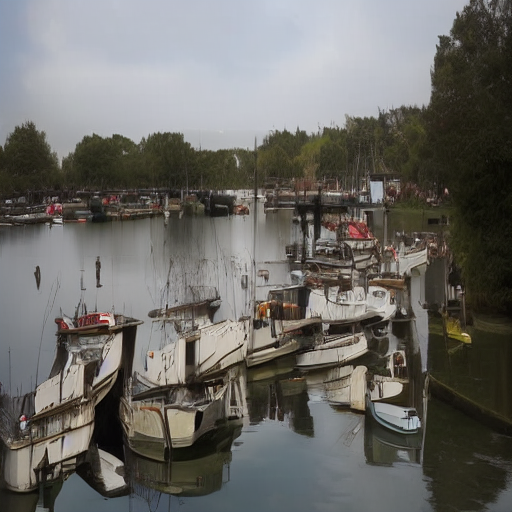

100%|██████████| 50/50 [00:04<00:00, 10.63it/s]


PROMPT 2 - SAMPLE 1 - TIME: 4.84s



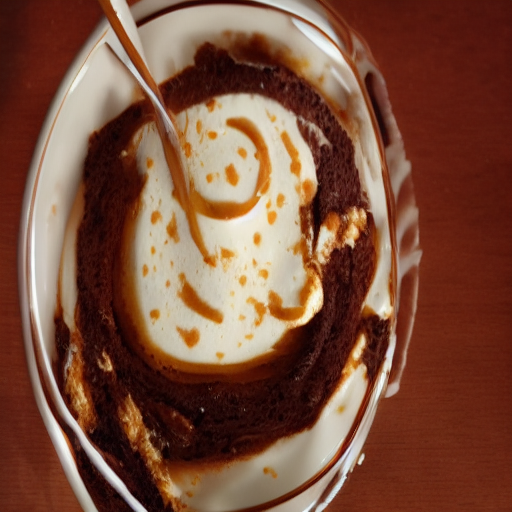

100%|██████████| 50/50 [00:04<00:00, 10.62it/s]


PROMPT 3 - SAMPLE 1 - TIME: 4.84s



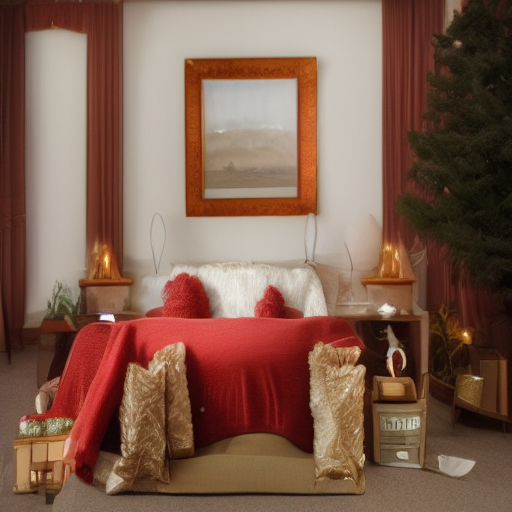

100%|██████████| 50/50 [00:04<00:00, 10.62it/s]


PROMPT 4 - SAMPLE 1 - TIME: 4.84s



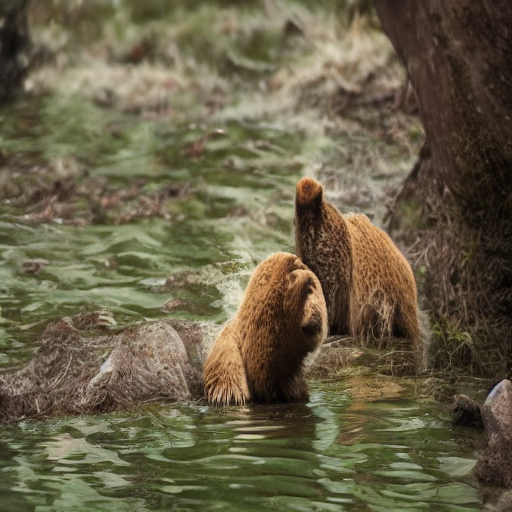

In [5]:
import torch
import torch.nn.functional as F
import os
import model_loader
import time
import pipeline
from PIL import Image
from transformers import CLIPTokenizer
from IPython.display import display

# Set the device
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# Load the models
models = model_loader.preload_models_from_standard_weights(model_file, DEVICE)
inference_unet_file = "data/last.pt"

if inference_unet_file is not None:
    # Load the UNet model
    print(f"Loading UNet model from {inference_unet_file}")
    models['diffusion'].load_state_dict(torch.load(inference_unet_file)['model_state_dict'])

# TEXT TO IMAGE
tokenizer = CLIPTokenizer("./data/vocab.json", merges_file="./data/merges.txt")

# Generate samples from the model
for i, prompt in enumerate(prompts):
    for j in range(num_samples):
        start = time.time()

        # Sample images from the model
        output_image = pipeline.generate(
            prompt=prompt,
            uncond_prompt=uncond_prompt,
            input_image=None,
            strength=0.9,
            do_cfg=do_cfg,
            cfg_scale=cfg_scale,
            sampler_name=sampler,
            n_inference_steps=num_inference_steps,
            seed=seed,
            models=models,
            device=DEVICE,
            idle_device=DEVICE,
            tokenizer=tokenizer,
        )

        end = time.time()

        print(f"PROMPT {i+1} - SAMPLE {j+1} - TIME: {end - start:.2f}s\n")

        # Save the generated image
        output_image = Image.fromarray(output_image)

        # Display the generated image
        display(output_image)

### Challenges v1

For the purpose of validating the model's training process, we have opted to utilize a representative dummy dataset. This dataset, while not the actual one, mirrors the format of the original CC3M dataset. It's worth noting that the CC3M dataset is considerably large, with a total size of approximately 430 GB. Given this substantial size, and considering our resource constraints, we have determined that it would not be feasible to complete the training process prior to the deadline for the first version, which is set for May 5. However, we have devised a plan to ensure that the training process is completed by the subsequent deadline for the second version, scheduled for May 31.

During the implementation of the model as described in the research paper, we encountered several areas of ambiguity that necessitated the formulation of certain assumptions. These assumptions, which guided our implementation, are detailed as follows:

1. The paper did not provide explicit information regarding whether the transformers employed for the image-to-text alignment task were part of a separate architecture or integrated within the proposed UNet middle blocks. Given this lack of clarity, our implementation treats the transformers as a distinct architecture.

2. The paper did not specify which blocks were to be modified to incorporate the dual stream deep fusion blocks. In our implementation, we have chosen to integrate these blocks into both the downsample and middle blocks of the original UNet, also known as Stable Diffusion. Notably, we did not apply these changes to the upsample layers, as they are not utilized in the image-to-text alignment task.

3. The term 'text query' was used in the paper without a clear definition. In our interpretation, we have chosen to represent the text query as the normalized average of the output from the text encoder.

4. The paper did not provide a clear methodology for the concatenation of the hidden latent image and the output of the fully connected layer. In our implementation, we expanded the output of the fully connected layer from a shape of (Batch Size, Channels) to (Batch Size, Channels, Height, Width), enabling its concatenation with the latent image, which also has a shape of (Batch Size, Channels, Height, Width).

5. The paper did not provide explicit instructions on how the fully connected layer projects the text query back into the text embedding space. We assumed that it generates an output with a shape of (Batch Size, Width * Height, 768). We then computed the normalized average of this output along dimension 1, resulting in an output of shape (Batch Size, 768). This output serves as the hidden text query that is input to the next layer.

### Challenges v2
1. We tried to train the model with resolution 256 x 256 and batch size 8. However, the results were unsatisfactory. Therefore, we decided to train the model with resolution 512 x 512 and batch size 1. The results were significantly better than the previous case. However, the training process was very slow due to the high resolution and low batch size. We were able to train the model for two-thirds of an epoch in 7 days.

2. We did not save the EMA model weights during training since we did not have enough VRAM. Therefore, we could not use the EMA model weights for testing. We directly used the last model weights for testing.

3. We could not train the model for 6 epochs as the paper did due to time constraints. Hence, we decided to use the Stable Diffusion v1.5 weights to fine-tune the model for two-thirds of an epoch.

4. We used different learning rate for the newly introduced parameters for the discriminative task. We used 1e-4 for the discriminative parameters and 1e-5 for the non-discriminative parameters with linear decay.

5) We used the MSE loss for the both generation and discriminative tasks. However, contrastive loss is used for the discriminative task in the paper. It was a mistake but we hope that it did not affect the results significantly. We changed the implementation to use contrastive loss for the discriminative task and we put a parameter to switch between the MSE loss and contrastive loss.

### Changes Made Based on the Given Peer Review
These are the changes that was included in the final version of the project.

**1) The authors of the paper are not specified**

Paper authors are added to the main Jupyter notebook.

**2) Notebook does not contain reproduced plots and/or tables, as declared**

The network is trained with the CC3M dataset and the results (sampled images and tables) are shared in the main jupyter notebook.

**3) The paper has partially achieved its goals and/or explained what is missing**

We implemented the necessary suggesstions and achieved our goals in version 1.

**4) The notebook does not contain a section that reproduces the figure(s) and table(s) declared in the goals.**

We included a seperate section for the results and shared the sampled images and tables in the main jupyter notebook.

**5) The notebook does not report the original values of the targeted quantitative results, for comparison.**

We added the original values of the targeted quantitative results for comparison in the main jupyter notebook.

**6) Implementation of the model is not complete. It is said that the transformer model for the text-image alignment part is not implemented.**

We implemented the image-text alignment transformer model.

**7) The notebook does not have titles for sections.**

We added titles for each section in the main jupyter notebook.

**8) The paper did not provide explicit information regarding whether the transformers employed for the image-to-text alignment task were part of a separate architecture or integrated within the proposed UNet middle blocks. Given this lack of clarity, our implementation treats the transformers as a distinct architecture.**

Review:
Although the authors use pre-trained autoencoder and UNet from Stable Diffusion v1-1,, the transformer part
should be trained from scratch. In the provided code, the group implemented this part as UNET_AttentionBlock
separately. The correct implementation should be taking the features from the middle block of UNet and process
in Attention block starting from scratch with 6 transformer blocks with 6 transformer blocks with 768 model width
and 64-dim attention heads (we observed that the implementation is different in the provided code.)

Answer:
We still think that the attention blocks in the down and middle block of the UNet should be changed with the dual-stream deep fusion attention blocks. The unique transformer with M transformer blocks and a linear predictor are added following the middle block of the UNet. The attention blocks used in the unique transformer are also follows a similar structure with the dual-stream deep fusion attention blocks. The unique transformer is trained from scratch by using the specified learning rate in the paper.

**9) The paper did not specify which blocks were to be modified to incorporate the dual stream deep fusion blocks. In our implementation, we have chosen to integrate these blocks into both the downsample and middle blocks of the original UNet, also known as Stable Diffusion. Notably, we did not apply these changes to the upsample layers, as they are not utilized in the image-to-text alignment task.**

Review:
The integration process should focus solely on the middle blocks, ensuring that the dual-stream deep fusion attention mechanism is effectively incorporated.

Answer:
We do not agree that the dual-stream deep fusion attention mechanism should only be incorporated into the middle blocks. The dual-stream deep fusion attention mechanism should be incorporated into both the downsample and middle blocks of the original UNet since in the paper it is stated that the authors propose a novel dual-stream network architecture, which fuses the noisy text embedding with the knowledge of latent images from **different scales** for image-text discriminative learning. Also, if the dual-stream deep fusion attention mechanism is only incorporated into the middle blocks, the model will not be able to learn the image-text alignment task effectively. The upsample layers are not utilized in the image-to-text alignment task, so the changes are not applied to the upsample layers.

**10) The term 'text query' was used in the paper without a clear definition. In our interpretation, we have chosen to represent the text query as the normalized average of the output from the text encoder.**

Review:
The text query is the normalized global representation of the text prompt.

Answer:
We kept the text query as the normalized global representation of the text prompt in our implementation and we tried to predict the original clean text query by using the diffusion-based image-text alignment task.

**11) The paper did not provide a clear methodology for the concatenation of the hidden latent image and the output of the fully connected layer. In our implementation, we expanded the output of the fully connected layer from a shape of (Batch Size, Channels) to (Batch Size, Channels, Height, Width), enabling its concatenation with the latent image, which also has a shape of (Batch Size, Channels, Height, Width).**

Review:
The paper indeed lacks explicit details on the concatenation process, but it does specify that the input to the transformer should be the concatenation of the flattened image's feature map and the text query outputted from the middle block of the UNet. Based on this, we recommend the following:

**Flattened Image's Feature Maps:** The latent image's feature map should be flattened before concatenation, which in this case would collapse the spatial dimensions (Height x Width) into one dimension while preserving the channel dimension.

**Fully Connected Layer Output:** Keep the output as (Batch Size, Channels) without expanding it to include spatial dimensions as this could introduce unnecessary complexity. So that you can concatenate these tensors along the channel dimension, resulting in a concatenated tensor with shape (Batch Size, Combined Channels).

Answer:
We agree with the reviewer's suggestion. We changed our implementation to concatanate the output of the fully connected layer with the flattened latent image's feature map. We concatenated the projected text query (Batch_Size, 320, 1) and hidden image (Batch_Size, 320, Height * Width). The concatenated tensor will have a shape of (Batch Size, 320, Height * Width + 1).

**12) The paper did not provide explicit instructions on how the fully connected layer projects the text query back into the text embedding space. We assumed that it generates an output with a shape of (Batch Size, Width * Height, 768). We then computed the normalized average of this output along dimension 1, resulting in an output of shape (Batch Size, 768). This output serves as the hidden text query that is input to the next layer.**

Review:
According to paper text query dimension $ e ∈ R^{1 \times d_y} $  so we think when concatenating with hidden latent image, the size will be image = (Batch Size, Width * Height, 768), text query =(Batch Size, 1, 768), concatenated result is =(Batch Size, Width * Height + 1, 768). Then, after the self attention layer they should split the embedding into 2 embedding, one is hidden latent image with attentioned the other is text query with attantioned. Finally, when they want to give embedding to Fully Connected layer, they just give text query=(Batch Size, 1, 768).

Answer:
We agree with the reviewer's suggestion. We changed our implementation to project the text query back into the text embedding space with a shape of (Batch Size, 1, 768). We also split the concatenated tensor into two parts, one for the hidden latent image and the other for the text query. The hidden text query and hidden latent image are used as the input to the next layer.